In [1]:
import os
from os import path
import numpy as np
import copy
import pandas as pd
import ipython_bell

from astropy.io import fits
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
from astropy.visualization import make_lupton_rgb
import sys

In [2]:
#Makes 3 plots per image: source simulation, lens cutout, complete simulation
def make_graphs(name, sim_i, sim_r, sim_g, cutout_i, cutout_r, cutout_g):
    fig, (ax1, ax2, ax3) = plt.subplots(figsize=(15, 4), ncols=3)

    ax1.set_title('Source(s)')
    ax1.xaxis.set_ticklabels([])
    ax1.yaxis.set_ticklabels([])
    original = ax1.imshow(sim_g, aspect='equal')
    fig.colorbar(original, ax=ax1)

    ax2.set_title('Lens')
    ax2.xaxis.set_ticklabels([])
    ax2.yaxis.set_ticklabels([])
    cutout = ax2.imshow(cutout_g, aspect='equal')
    fig.colorbar(cutout, ax=ax2)
            
    ax3.set_title('Complete Simulation')
    ax3.xaxis.set_ticklabels([])
    ax3.yaxis.set_ticklabels([])
    projection = ax3.imshow(sim_g+cutout_g, aspect='equal')
    fig.colorbar(projection, ax=ax3)
    plt.show()
    
    fig, (ax1, ax2, ax3) = plt.subplots(figsize=(15, 4), ncols=3)

    rgb = make_lupton_rgb(sim_i, sim_r, sim_g, Q=11., stretch=40.)
    ax1.set_title('Source(s)')
    ax1.xaxis.set_ticklabels([])
    ax1.yaxis.set_ticklabels([])
    ax1.matshow(rgb)
    #original = ax1.imshow(rgb, aspect='equal')#, vmin=0, vmax = 250)
    #fig.colorbar(original, ax=ax1)

    rgb = make_lupton_rgb(cutout_i, cutout_r, cutout_g, Q=11., stretch=40.)
    ax2.set_title('Lens')
    ax2.xaxis.set_ticklabels([])
    ax2.yaxis.set_ticklabels([])
    cutout = ax2.imshow(rgb, aspect='equal')
    #fig.colorbar(cutout, ax=ax2)
            
    rgb = make_lupton_rgb(sim_i+cutout_i, sim_r+cutout_r, sim_g+cutout_g, Q=11., stretch=40.)
    ax3.set_title('Complete Simulation')
    ax3.xaxis.set_ticklabels([])
    ax3.yaxis.set_ticklabels([])
    projection = ax3.imshow(rgb, aspect='equal')
    #fig.colorbar(projection, ax=ax3)
    plt.show()

In [3]:
def complete_simulations(m, ids):
    directory_sim = '/Users/jimenagonzalez/research/DSPL/Simulations-Double-Source-Gravitational-Lensing/Data/Sim/'
    directory_cutouts = '/Users/jimenagonzalez/research/DSPL/Simulations-Double-Source-Gravitational-Lensing/Data/lens_cutouts/'
    end_name = ['_g.fits', '_i.fits', '_r.fits']
    x = np.zeros((1,3,46,46)) #Complete Simulations
    n = 0
    for lens_id in ids:
        path_sim_id = directory_sim + str(lens_id)
        if(n >= m):
            break
        #check that the sim id folder exist (if not continue)
        if(os.path.exists(path_sim_id) == False):
            continue
        num_sim_id = int(len(os.listdir(path_sim_id))/3) # num sim with same lens
        #loop on each simulation produced using the same lens
        for j in range(1, num_sim_id+1):
            n += 1 #number of total simulations
            path_cutout = directory_cutouts + str(lens_id) 
            path_sim = path_sim_id + '/' + str(j)
            if(os.path.exists(path_cutout + end_name[0]) == False): 
                continue
            with fits.open(path_cutout + end_name[0]) as hdul: cutout_g = hdul[0].data
            with fits.open(path_cutout + end_name[1]) as hdul: cutout_i = hdul[0].data
            with fits.open(path_cutout + end_name[2]) as hdul: cutout_r = hdul[0].data
            with fits.open(path_sim + end_name[0]) as hdul: sim_g = hdul[0].data
            with fits.open(path_sim + end_name[1]) as hdul: sim_i = hdul[0].data
            with fits.open(path_sim + end_name[2]) as hdul: sim_r = hdul[0].data
            ele_sim = np.array([cutout_g + sim_g, cutout_r + sim_r, cutout_i + sim_i])
            x = np.append(x, [ele_sim], axis = 0)
            make_graphs(str(lens_id), sim_i, sim_r, sim_g, cutout_i, cutout_r, cutout_g)
            
    x = np.delete(x, 0, axis = 0)
    return(x)

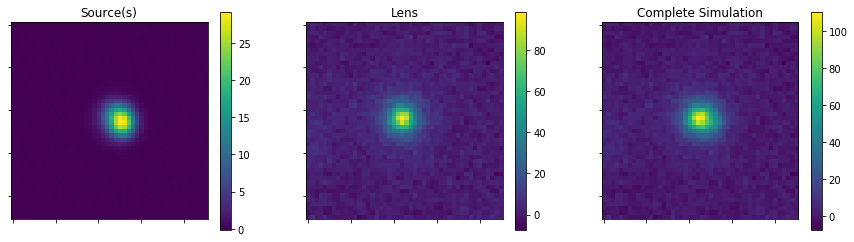

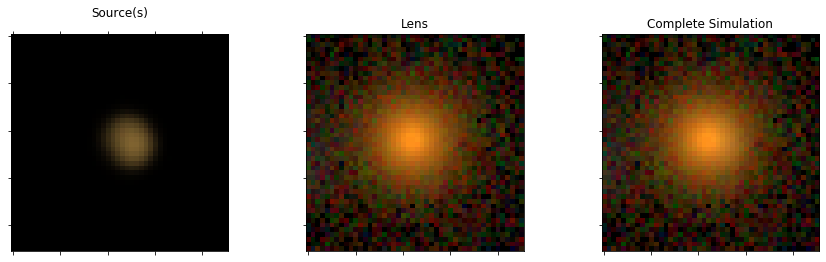

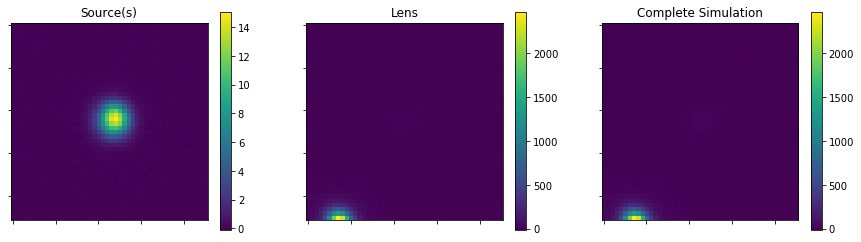

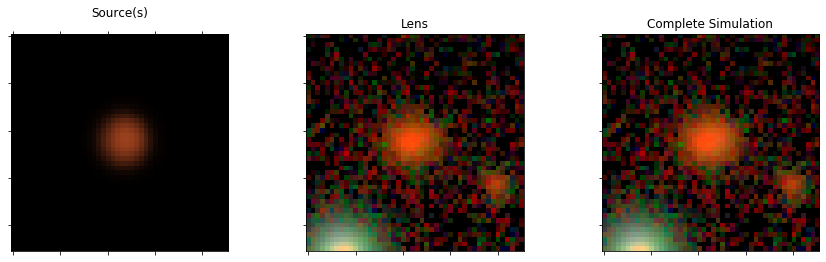

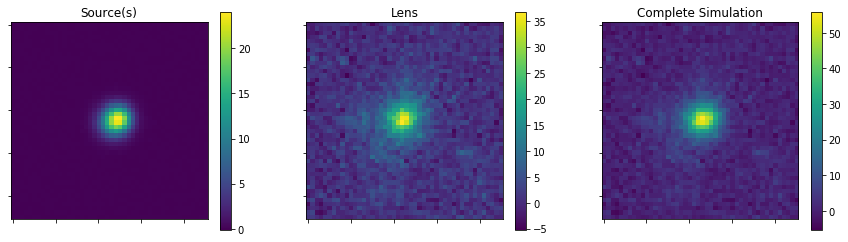

...

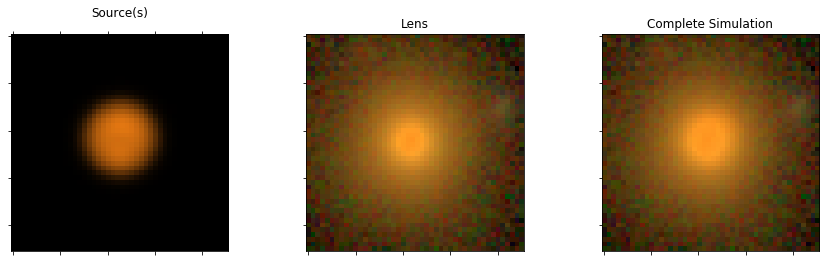

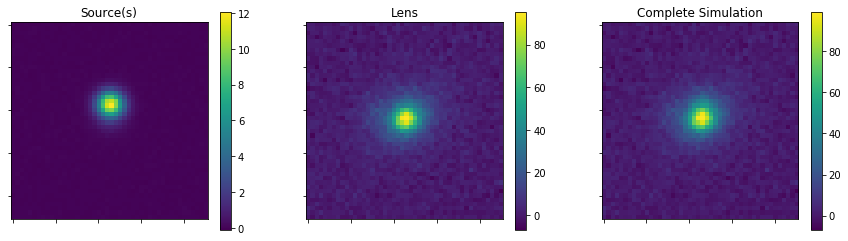

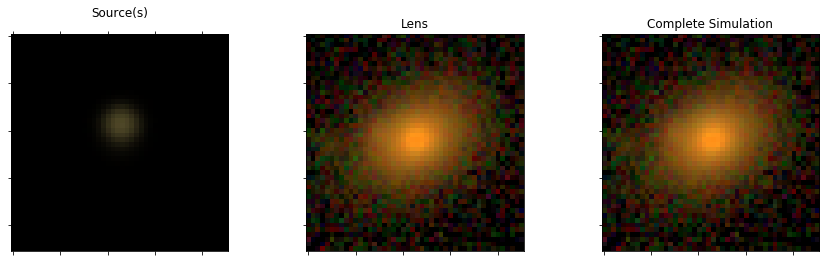

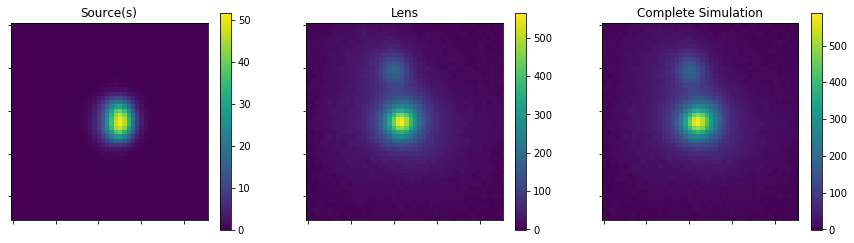

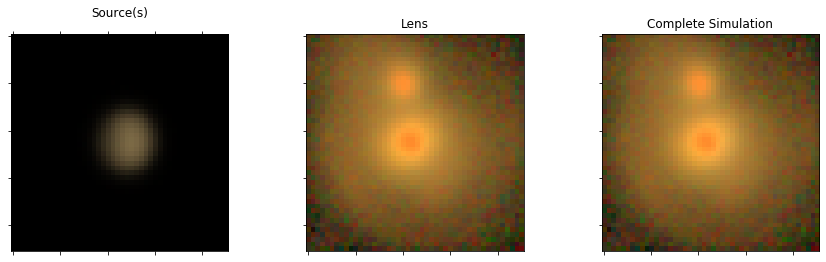

356


In [4]:
#19712 lens cutouts
path = '/Users/jimenagonzalez/research/DSPL/Simulations-Double-Source-Gravitational-Lensing/'
ids = pd.read_csv(path + 'Data/all_data_sim.csv')['COADD_OBJECT_ID'].sample(frac = 1)
x = complete_simulations(1000, ids)
print(len(x))